In [ ]:
%load_ext autoreload
%autoreload 2

In [ ]:
%run Custom_Dataset.ipynb
%run Nibronet2_Model.ipynb
%run Extra_Utilities.ipynb

In [ ]:
from sklearn.model_selection import train_test_split
import os,gc
import cv2
import random
import numpy as np
from PIL import Image, ImageStat
from torch.utils.data import Dataset, DataLoader,random_split
from torch import randperm,unique
from torch._utils import _accumulate
import torchvision.transforms.functional as F
import xml.etree.ElementTree as ET
import matplotlib.pyplot as plt
import torch.optim as optim
from torch.optim import lr_scheduler
import time
from skimage import io, transform
import sklearn.metrics as skm
import torch.nn as nn
from torchvision import datasets, transforms, models
from torch import manual_seed,zeros_like,zeros,ones,unique,autograd,device,cuda,cat,save,load,tensor,utils,rand
from torch import sum as torch_sum
manual_seed(17)
random.seed(17)

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = NimbroNet2()
model.to(device)

In [ ]:
trs = [transforms.ToTensor()]

In [ ]:
path = "/content/drive/My Drive/Final Model Checkpoints/Checkpoint_epoch125.th"
checkpoint = torch.load(path, map_location=lambda storage, loc: storage)
#print(checkpoint['model_state_dict'])
model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
epoch_init = checkpoint['epoch']
#train_loader_alltogether = checkpoint['train_loader_alltogether']
test_loader_detection = checkpoint['DetectionTestDataLoader']
val_loader_detection = checkpoint['DetectionValidationDataLoader']
test_loader_segmentation = checkpoint['SegmentationTestDataLoader']
val_loader_segmentation = checkpoint['SegmentationValidationDataLoader']
train_loader_detection = checkpoint['DetectionTrainDataLoader']
train_loader_segmentation = checkpoint['SegmentationTrainDataLoader']
loss_d = checkpoint['loss_d']
loss_s = checkpoint['loss_s']

In [ ]:
def find_center_contour(image):
  gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  #plt.imshow(gray)
  #plt.show()
  blurred = cv2.GaussianBlur(gray, (3, 3), 2)
  #plt.imshow(blurred)
  #plt.show()
  # convert the grayscale image to binary image
  ret,thresh = cv2.threshold(blurred,250,255,0)
  
  #plt.imshow(thresh)
  #plt.show()

  # find contours in the binary image
  contours, hierarchy = cv2.findContours(thresh.astype(np.uint8),cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
  ball_centers = []
  goalpost_centers = []
  robot_centers = []
  for c in contours:
    # calculate moments for each contour
    M = cv2.moments(c)

    # calculate x,y coordinate of center
    if M["m00"] != 0:
      cX = int(M["m10"] / M["m00"])
    else:
      cX = 100000
    if M["m00"] != 0:
      cY = int(M["m01"] / M["m00"])
    else:
      cY = 100000
    
    if (cX != 100000) and (cY != 100000):
      # if it has a ball color
      if image[cY,cX,0] < 200:     
        ball_centers.append((cX,cY))
      # if it has goalpost color
      elif image[cY,cX,1] < 200:
        goalpost_centers.append((cX,cY))
      #if it has robot color
      elif image[cY,cX,2] < 200:
        robot_centers.append((cX,cY))

  return ball_centers,goalpost_centers,robot_centers

In [ ]:
def get_confusion_matrix(model_output_centers, ground_truth_centers):
  radius = 10 #pixels
  TP = 0
  FN = 0
  FP = 0
  
  gt_length = len(ground_truth_centers)
  model_length = len(model_output_centers)

  objects_detected = np.zeros(gt_length)
  
  for k in range(model_length):
    found = -1
    for l in range(gt_length):
        #print("ouput center = ",model_output_centers[k])
        #print("gt center = ",ground_truth_centers[l])
        dist = distance.euclidean(model_output_centers[k],ground_truth_centers[l])
        #print('dist',dist) 
        if dist <= radius:
          #print("found")  
          TP +=1
          found = l
          break
    if found == -1: #if found is not changed => object is detected by the model but not in ground truth 
      FP += 1 
    else:
      objects_detected[found] = 1
  FN = np.count_nonzero(objects_detected == 0)
  #print("Tp = ", TP)
  #print("FN = ", FN)
  #print("FP = ",FP)
  return TP, FP, FN

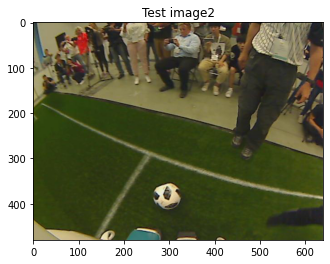

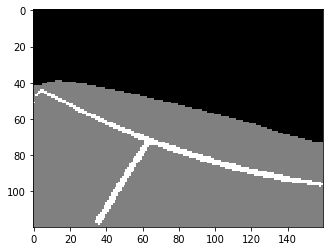

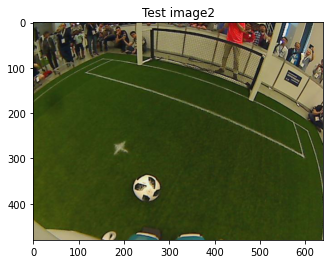

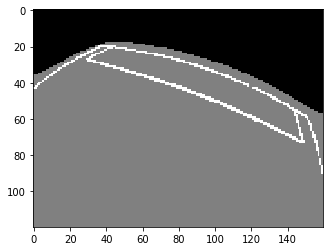

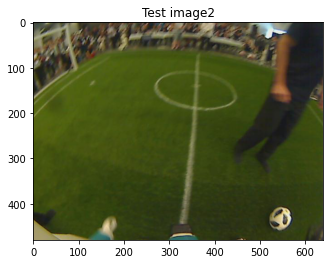

...

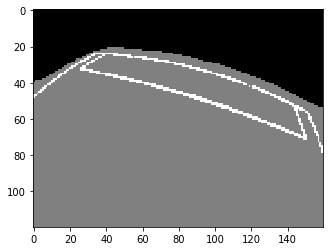

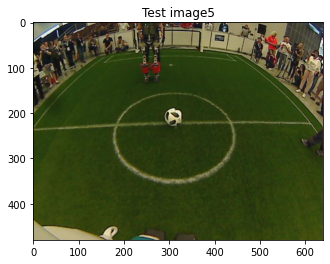

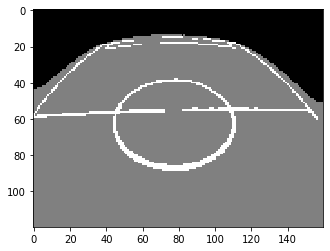

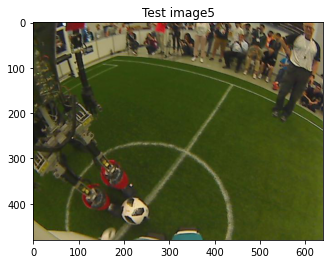

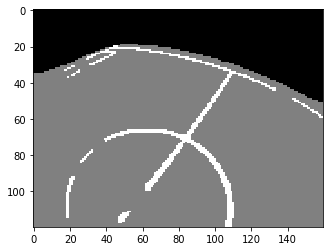

In [ ]:
model.eval()
k=1
SMOOTH = 1e-6
lossv, accv = [], []
total_train = 0
correct_train = 0
acc0 = []
acc1 = []
acc2 = []
iou0 = []
iou1 = []
iou2 = []
for j,train_data in enumerate(test_loader_segmentation):
      k +=1

      images = train_data['image'].to(device)
      images2 = train_data['input'].to(device)
      labels = train_data['target'].to(device)
      images.requires_grad_(False)
      images2.requires_grad_(False)
      labels.requires_grad_(False)
      
      output,_ = model(images)

      for i in range(output.shape[0]):
        a = output[i].argmax(0)
        _, predicted = torch.max(output.data, 1)
        b = predicted.cpu().detach().numpy()
        a = labels.cpu().detach().numpy() 
        pred_0 = np.count_nonzero(b == 0)
        label_0 = np.count_nonzero(a == 0)
        intersection_0 = sum((a==0)[b==0])
        acc0.append(intersection_0 / label_0)
        union_0 = pred_0 + label_0 - intersection_0
        iou = (intersection_0 + SMOOTH) / (union_0 + SMOOTH)
        iou0.append(iou)

        b = predicted.cpu().detach().numpy()
        a = labels.cpu().detach().numpy() 
        pred_1 = np.count_nonzero(b == 1)
        label_1 = np.count_nonzero(a == 1)
        intersection_1 = sum((a==1)[b==1])
        acc1.append(intersection_1 / label_1)
        union_1 = pred_1 + label_1 - intersection_1
        iou = (intersection_1 + SMOOTH) / (union_1 + SMOOTH)
        iou1.append(iou)

        b = predicted.cpu().detach().numpy()
        a = labels.cpu().detach().numpy() 
        pred_2 = np.count_nonzero(b == 2)
        label_2 = np.count_nonzero(a == 2)
        intersection_2 = sum((a==2)[b==2])
        acc2.append(intersection_2 / label_2)
        union_2 = pred_2 + label_2 - intersection_2
        iou = (intersection_2 + SMOOTH) / (union_2 + SMOOTH)
        iou2.append(iou)
      
      output = output.data.max(1)[1]

      for i in range(output.shape[0]):

        plt.title('Test image' + str(k))
        image = np.uint8(np.asanyarray(transforms.ToPILImage()(images2[i].cpu())))

        plt.imshow(image)
        plt.show()

        img = output[i].cpu()
        img[img == 0] = 0
        img[img == 2] = 255 
        img[img == 1] = 128
        
        plt.imshow(img, cmap='gray', vmin=0, vmax=255,interpolation='nearest')
        plt.show()


In [ ]:
acc00=0
acc11=0 
acc22 =0
for i in acc0:
  acc00 += i
acc00 /= len(acc0) 
print('Accuracy for background is' , acc00*100)

for i in acc1:
  acc11 += i
acc11 /= len(acc1) 
print('Accuracy for field is' , acc11*100)

for i in acc2:
  acc22 += i
acc22 /= len(acc2) 
print('Accuracy for lines is' , acc22*100)

Accuracy for background is 97.34614320766694
Accuracy for field is 98.76692465587568
Accuracy for lines is 86.99591821221846


In [ ]:
iou00=0
iou11=0 
iou22 =0
for i in iou0:
  #print(i)
  iou00 += i
iou00 /= len(iou0) 
print('IOU for background is' , iou00)

for i in iou1:
  #print(i)
  iou11 += i
iou11 /= len(iou1) 
print('IOU for field is' , iou11)

for i in iou2:
  iou22 += i
iou22 /= len(iou2) 
print('IOU for lines is' , iou22)

IOU for background is 0.9573815511505217
IOU for field is 0.9680274398852787
IOU for lines is 0.8085485166310415


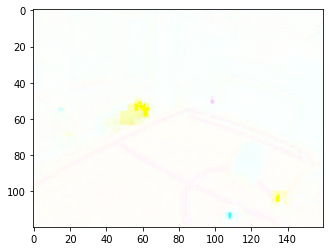

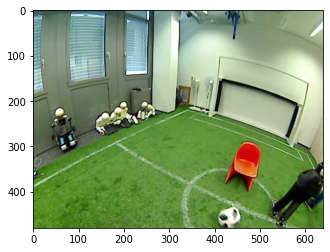

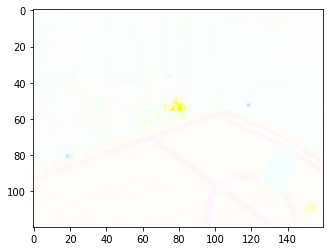

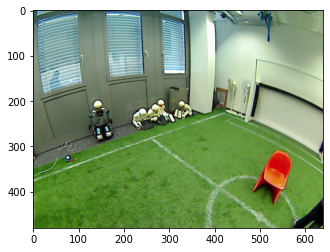

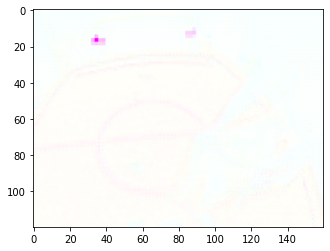

...

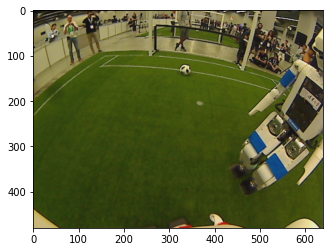

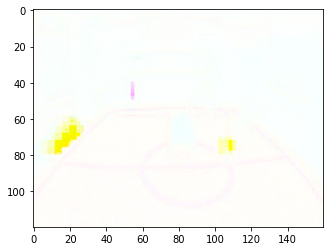

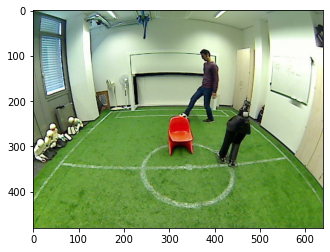

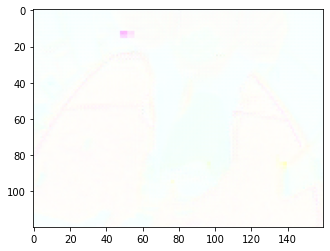

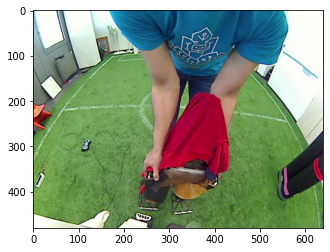

Accuracy for ball tensor(0.7983)
Accuracy for goal post tensor(0.0572)
Accuracy for robot tensor(0.4279)
Precision for ball tensor(0.8976)
Precision for goal post tensor(0.8704)
Precision for robot tensor(0.7766)
Recall for ball tensor(0.8783)
Recall for goal post tensor(0.0577)
Recall for robot tensor(0.4879)
FDR for ball tensor(0.1024)
FDR for goal post tensor(0.1296)
FDR for robot tensor(0.2234)
F1 for ball tensor(0.8878)
F1 for goal post tensor(0.1083)
F1 for robot tensor(0.5993)


In [ ]:
TP_all = torch.zeros(3)
FP_all = torch.zeros(3)
FN_all = torch.zeros(3)
recall = torch.zeros(3)
precision = torch.zeros(3)
fdr = torch.zeros(3)
accuracy = torch.zeros(3)
f1 = torch.zeros(3)
topil = transforms.ToPILImage()

model.eval()
for j,test_data in enumerate(test_loader_detection):

      images = test_data['image'].to(device)
      labels = test_data['heatmap'].to(device)
      
      _,output = model(images)
      output[output<=0.6] = 0
      output[output>1] =1

      for i in range(output.shape[0]):

        output_ball_centers,output_goalpost_centers,output_robot_centers = find_center_contour(np.asarray(topil(output[i])))

        ground_truth_ball_centers,ground_truth_goalpost_centers,ground_truth_robot_centers = find_center_contour(np.asarray(topil(labels[i])))
        
        # get confussion matrix for ball
        TP, FP, FN = get_confusion_matrix(output_ball_centers, ground_truth_ball_centers)

        TP_all[0] += TP 
        FP_all[0] += FP 
        FN_all[0] += FN
        
        # get confussion matrix for goalpost
        TP, FP, FN = get_confusion_matrix(output_goalpost_centers, ground_truth_goalpost_centers)
        TP_all[1] += TP 
        FP_all[1] += FP 
        FN_all[1] += FN

        if TP > 0:
          plt.imshow(np.asarray(topil(output[i])))
          plt.show()
          plt.imshow(np.asarray(topil(images[i])))
          plt.show()

        # get confussion matrix for robot
        TP, FP, FN = get_confusion_matrix(output_robot_centers, ground_truth_robot_centers)
        TP_all[2] += TP 
        FP_all[2] += FP 
        FN_all[2] += FN 

# Calculating the accuracy metrics
for i in range(3):

  if (FP_all[i].mean() + TP_all[i].mean() + FN_all[i].mean() ) != 0:
   accuracy[i] = TP_all[i].mean() / (FP_all[i].mean() + TP_all[i].mean() + FN_all[i].mean() )
  
  if (TP_all[i] + FN_all[i] ) != 0:
    recall[i] = TP_all[i] / (TP_all[i] + FN_all[i] )
  
  if (TP_all[i] + FP_all[i]) != 0:
    precision[i] = TP_all[i] / (TP_all[i] + FP_all[i])
    fdr[i] = FP_all[i] / (TP_all[i] + FP_all[i])
  
  if (precision[i] + recall[i]) != 0:
    f1[i] = 2 * (precision[i] * recall[i]) / (precision[i] + recall[i])

print("Accuracy for ball", str(accuracy[0].mean()))       
print("Accuracy for goal post", str(accuracy[1].mean()))
print("Accuracy for robot", str(accuracy[2].mean()))

print("Precision for ball", precision[0].mean())     
print("Precision for goal post", str(precision[1].mean()))
print("Precision for robot", str(precision[2].mean()))

print("Recall for ball", str(recall[0].mean()))    
print("Recall for goal post", str(recall[1].mean()))   
print("Recall for robot", str(recall[2]))   

print("FDR for ball", str(fdr[0].mean()))         
print("FDR for goal post", str(fdr[1].mean()))   
print("FDR for robot", str(fdr[2].mean()))   

print("F1 for ball", str(f1[0].mean()))      
print("F1 for goal post", str(f1[1].mean()))  
print("F1 for robot", str(f1[2].mean()))  
